In [1]:
using DrWatson
@quickactivate "Doran_etal_2022"

In [2]:
using Muon
using NewickTreeTools
using Phylo
using StatsPlots

In [9]:
# biobank = readh5mu(joinpath(datadir(), "exp_pro", "BB673", "BB673.h5mu"))
bb_spi_tree = readnw(biobank["oggs"].uns["inferrednewicktree_UP7047"]);
as_polytomy!(bb_spi_tree, fun=n->NewickTree.distance(n)<1e-8)
plottree = parsenewick(nwstr(bb_spi_tree))
sort!(plottree)

RootedTree with 673 tips, 1332 nodes and 1331 branches.
Leaf names are MSK.20.82_unclassified, MSK.13.34_Clostridium_innocuum, MSK.7.7_Clostridium_innocuum, MSK.5.23_Clostridium_innocuum, MSK.6.1_Clostridium_innocuum, ... [667 omitted] ... and MSK.17.39_Coprococcus_comes


In [5]:
pdir = plotsdir("BB673treeplots")
mkpath(pdir)

"/Users/ben/projects/Doran_etal_2022/plots/BB673treeplots"

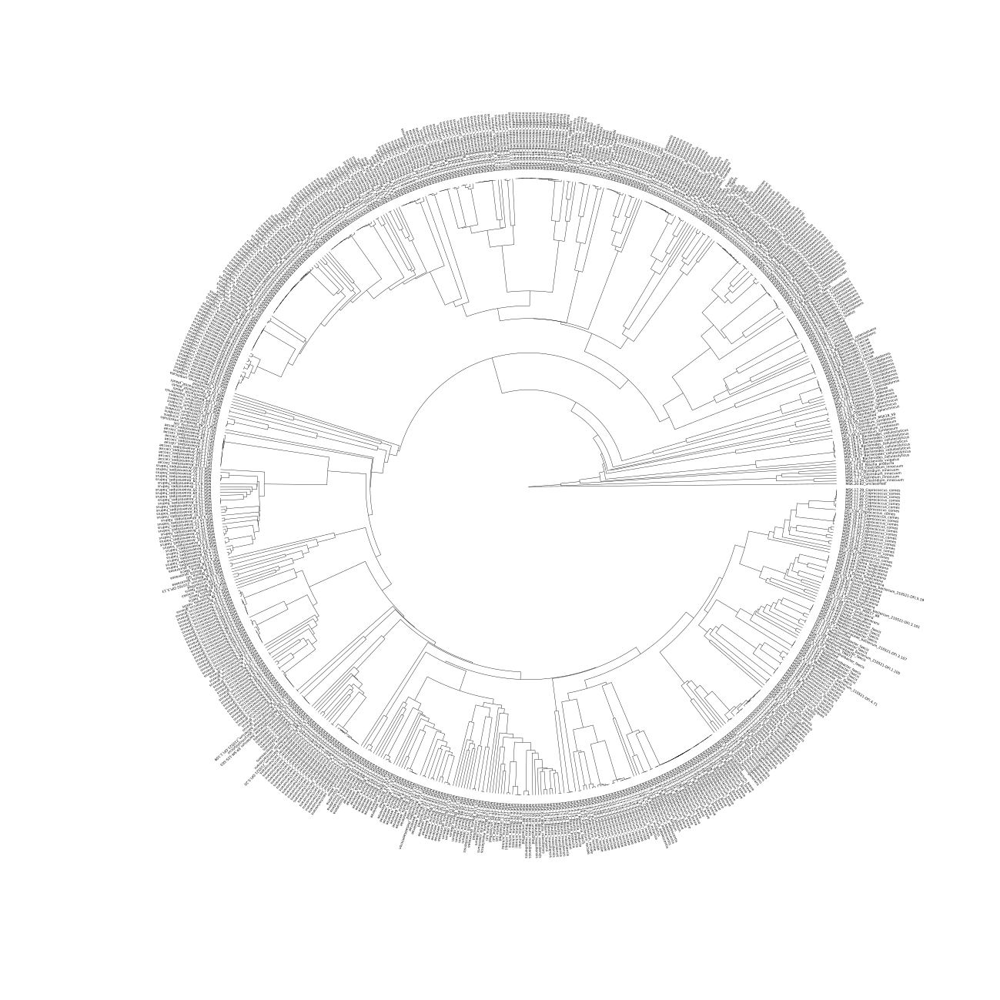

In [17]:
plot(plottree, treetype=:fan, 
    size = (1300, 1300), 
    tipfont = (3,),
    linewidth=.4, 
    showtips=true)

In [19]:
savefig(joinpath(pdir, "fullBB673tree.svg"))

In [49]:
leaves = NewickTree.getleaves(bb_spi_tree);
leafid = findfirst(x->contains(name(x),"MSK.17.15"), leaves)

102

In [50]:
compose(f, n) = reduce(∘, ntuple(_ -> f, n))
subtree = compose(parent, 2)(leaves[leafid]);

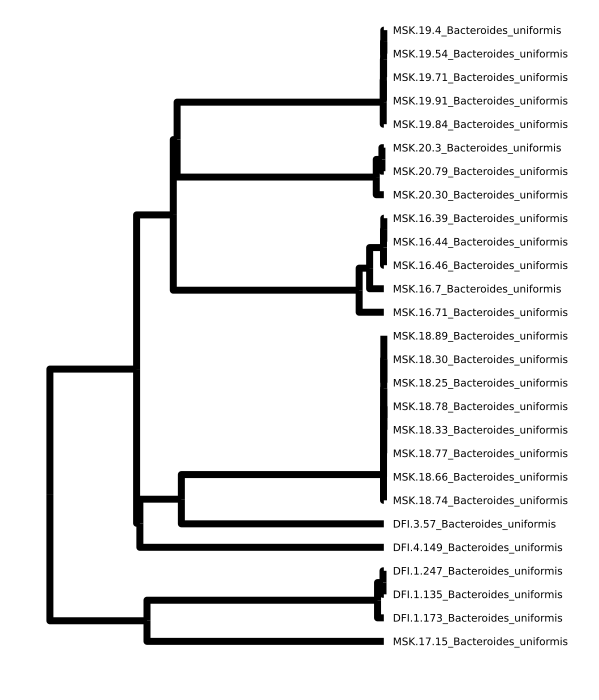

In [54]:
plotsubtree = parsenewick(nwstr(subtree))
sort!(plotsubtree)
plot(plotsubtree, rightmargin=4Plots.Measures.cm, lw=7, size=(600, 700))

In [55]:
savefig(joinpath(pdir, "Buniformis_subtree"))